##### RAPIDS cuML kNN - Find Similar Images
In this notebook, we show how to use RAPIDS cuML kNN with CNN image embeddings to find similar images. This is a useful technique that can be used in many computer vision tasks. If you have one image and want to find similar images from a collection of images, you can use this technique. (For example, search internet images for similar images to a specific image, or search a database of images, or compete in Kaggle's Google Landmark Retrieval Competition [here][1])

Using this technique, we find 6 images in this competition's test dataset that are in last years 2019 train dataset. Therefore we know these 6 answers perfectly.

Extracting CNN embeddings is a useful skill by itself. Once you have embeddings in a dataframe, you can train any ML model to classify Melanoma images using embeddings dataframe and ignoring the original images. And you can add more features like meta features to your embeddings for improved accuracy. I will demonstrate training a simple ML model using embeddings.

Lastly we will explore clusters of images in the embeddings space using RAPIDS cuML KMeans and RAPIDS cuML TSNE.

[1]: https://www.kaggle.com/c/landmark-retrieval-2020


# Initialize Environment
We will use TensorFlow to extract CNN image embeddings and RAPIDS cuML kNN to compare them. We will restrict TensorFlow to only use 75% of GPU VRAM so that RAPIDS has 25% of GPU VRAM. Note that we only need to extract embeddings in the first version of this notebook and save them to a Kaggle dataset. Then in subsequent versions, we can load the embeddings from the Kaggle dataset. Do this if you wish to explore larger embeddings that take longer to extract.

In [1]:
DIM = 256; EFFN = 0; BATCH_SIZE = 128
LOAD_EMBEDDINGS = False
if LOAD_EMBEDDINGS: print('We will read embeddings from Kaggle dataset')
else: print('We will extract embeddings from pretrained CNN')
PATH_TO_EMBEDDINGS = '../input/embeddings-melanoma/'

We will extract embeddings from pretrained CNN


In [2]:
# INSTALL RAPIDS
import sys
!cp ../input/rapids/rapids.0.14.0 /opt/conda/envs/rapids.tar.gz
!cd /opt/conda/envs/ && tar -xzvf rapids.tar.gz > /dev/null
sys.path = ["/opt/conda/envs/rapids/lib/python3.7/site-packages"] + sys.path
sys.path = ["/opt/conda/envs/rapids/lib/python3.7"] + sys.path
sys.path = ["/opt/conda/envs/rapids/lib"] + sys.path 
!cp /opt/conda/envs/rapids/lib/libxgboost.so /opt/conda/lib/

# INSTALL EFFICIENT NET
!pip install -q efficientnet >> /dev/null

In [3]:
# LOAD LIBRARIES
import pandas as pd, numpy as np
import tensorflow as tf, re, math
import tensorflow.keras.backend as K
import efficientnet.tfkeras as efn
from sklearn.model_selection import KFold
from sklearn.metrics import roc_auc_score
import matplotlib.pyplot as plt, cv2
import cuml #, cupy
print('RAPIDS version',cuml.__version__)

RAPIDS version 0.14.0+0.g31202da.dirty


In [4]:
# RESTRICT TENSORFLOW TO 12GB OF GPU RAM
# SO THAT WE HAVE GPU RAM FOR RAPIDS CUML KNN
LIMIT = 12
if LOAD_EMBEDDINGS: LIMIT = 0
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    tf.config.experimental.set_virtual_device_configuration(
        gpus[0],
        [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=1024*12)])
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    print(e)
print('Restrict TensorFlow to max %iGB GPU RAM'%LIMIT)

1 Physical GPUs, 1 Logical GPUs
Restrict TensorFlow to max 12GB GPU RAM


# TFRecords Helper Functions
The following are helper functions to load TFRecords. This are from AgentAuers' notebook [here][1]

[1]: https://www.kaggle.com/agentauers/incredible-tpus-finetune-effnetb0-b6-at-once

In [5]:
def read_labeled_tfrecord(example):
    tfrec_format = {
        'image'                        : tf.io.FixedLenFeature([], tf.string),
        'image_name'                   : tf.io.FixedLenFeature([], tf.string),
        'target'                       : tf.io.FixedLenFeature([], tf.int64)
    }           
    example = tf.io.parse_single_example(example, tfrec_format)
    return example['image'], example['target']


def read_unlabeled_tfrecord(example, return_image_name):
    tfrec_format = {
        'image'                        : tf.io.FixedLenFeature([], tf.string),
        'image_name'                   : tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(example, tfrec_format)
    return example['image'], example['image_name'] if return_image_name else 0

 
def prepare_image(img, augment=True, dim=256):    
    img = tf.image.decode_jpeg(img, channels=3)
    # NORMALIZE IMAGES TO IMAGENET PRETRAIN
    img = ((tf.cast(img, tf.float32) / 255.0) - 0.449) / 0.226                      
    img = tf.reshape(img, [dim,dim, 3])
    return img

def count_data_items(filenames):
    n = [int(re.compile(r"-([0-9]*)\.").search(filename).group(1)) 
         for filename in filenames]
    return np.sum(n)

In [6]:
def get_dataset(files, augment = False, shuffle = False, repeat = False, 
                labeled=True, return_image_names=True, batch_size=32, dim=128):
    
    ds = tf.data.TFRecordDataset(files, num_parallel_reads=AUTO)
    ds = ds.cache()
    
    if repeat:
        ds = ds.repeat()
    
    if shuffle: 
        ds = ds.shuffle(1024*8)
        opt = tf.data.Options()
        opt.experimental_deterministic = False
        ds = ds.with_options(opt)
        
    if labeled: 
        ds = ds.map(read_labeled_tfrecord, num_parallel_calls=AUTO)
    else:
        ds = ds.map(lambda example: read_unlabeled_tfrecord(example, return_image_names), 
                    num_parallel_calls=AUTO)      
    
    ds = ds.map(lambda img, imgname_or_label: (prepare_image(img, augment=augment, dim=dim), 
                                               imgname_or_label), 
                num_parallel_calls=AUTO)
    
    ds = ds.batch(batch_size * REPLICAS)
    ds = ds.prefetch(AUTO)
    return ds

# Extract Image Features
We will extract image embeddings from EfficientNet B0 using images of size `256x256`. If the variable `LOAD_EMBEDDINGS=True` then we will load them from a previous notebook version Kaggle dataset. If `LOAD_EMBEDDINGS=False`, we will extract them. Note that we are using `noisy-student` pretrained weights for better features. And in the TFRecord read function above, we normalize our inputs by subtracting ImageNet mean of `0.449` and dividing by ImageNet standard deviation of `0.226`. This is important for image feature extraction because we are not training the EfficientNet anymore. If we were training more, then the model would correct itself if we don't normalize.

In [7]:
# EXTRACT LAST LAYER OF EFFICIENT NET WITH GLOBAL AVERAGE POOLING
EFNS = [efn.EfficientNetB0, efn.EfficientNetB1, efn.EfficientNetB2, efn.EfficientNetB3, 
        efn.EfficientNetB4, efn.EfficientNetB5, efn.EfficientNetB6]

def build_model(dim=256, ef=EFFN):
    inp = tf.keras.layers.Input(shape=(dim,dim,3))
    base = EFNS[ef](input_shape=(dim,dim,3),weights='imagenet',include_top=False)
    x = base(inp)
    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    model = tf.keras.Model(inputs=inp,outputs=x)
    return model

In [8]:
# TFRECORDS PATH
GCS_PATH = '../input/melanoma-%ix%i'%(DIM,DIM) # GPU does not need KaggleDatasets()
files_train = np.sort(np.array(tf.io.gfile.glob(GCS_PATH + '/train*.tfrec')))
files_test  = np.sort(np.array(tf.io.gfile.glob(GCS_PATH + '/test*.tfrec')))
AUTO     = tf.data.experimental.AUTOTUNE; REPLICAS = 1

In [9]:
files_train

array(['../input/melanoma-256x256/train00-2182.tfrec',
       '../input/melanoma-256x256/train01-2185.tfrec',
       '../input/melanoma-256x256/train02-2193.tfrec',
       '../input/melanoma-256x256/train03-2182.tfrec',
       '../input/melanoma-256x256/train04-2167.tfrec',
       '../input/melanoma-256x256/train05-2171.tfrec',
       '../input/melanoma-256x256/train06-2175.tfrec',
       '../input/melanoma-256x256/train07-2174.tfrec',
       '../input/melanoma-256x256/train08-2177.tfrec',
       '../input/melanoma-256x256/train09-2178.tfrec',
       '../input/melanoma-256x256/train10-2174.tfrec',
       '../input/melanoma-256x256/train11-2176.tfrec',
       '../input/melanoma-256x256/train12-2198.tfrec',
       '../input/melanoma-256x256/train13-2186.tfrec',
       '../input/melanoma-256x256/train14-2174.tfrec'], dtype='<U44')

In [11]:
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
user_credential = user_secrets.get_gcloud_credential()
user_secrets.set_tensorflow_credential(user_credential)
from kaggle_datasets import KaggleDatasets
# GCS_DS_PATH_tr = KaggleDatasets().get_gcs_path('15-folds-isic-256-256')
files_train = np.sort(np.array(tf.io.gfile.glob(['../input/15-folds-isic-256-256'+'/isic20F' +str(x)+'tr00-*.tfrec' for x in range(15)])))
files_test  = np.sort(np.array(tf.io.gfile.glob(['../input/15-folds-isic-256-256'+'/isic20testtr0' +str(x)+'-*.tfrec' for x in range(4)])))

In [12]:
files_test

array(['../input/15-folds-isic-256-256/isic20testtr00-3000.tfrec',
       '../input/15-folds-isic-256-256/isic20testtr01-3000.tfrec',
       '../input/15-folds-isic-256-256/isic20testtr02-3000.tfrec',
       '../input/15-folds-isic-256-256/isic20testtr03-1875.tfrec'],
      dtype='<U56')

## Test Image Embeddings

In [13]:
if not LOAD_EMBEDDINGS:
    model = build_model(dim=DIM,ef=EFFN)
    ds_test = get_dataset(files_test,labeled=False,return_image_names=False,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    embed_test = model.predict(ds_test,verbose=1)
    np.save('embed_test_%i_%i'%(DIM,EFFN),embed_test.astype('float32'))
else:
    embed_test = np.load(PATH_TO_EMBEDDINGS+'embed_test_%i_%i.npy'%(DIM,EFFN))
print('test embeddings shape',embed_test.shape)

85/85 [==============================] - 18s 206ms/step
test embeddings shape (10875, 1280)


## Train Image Embeddings

In [14]:
if not LOAD_EMBEDDINGS:
    model = build_model(dim=DIM,ef=EFFN)
    ds_train = get_dataset(files_train,labeled=False,return_image_names=False,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    embed = model.predict(ds_train,verbose=1)
    np.save('embed_train_%i_%i'%(DIM,EFFN),embed.astype('float32'))
else:
    embed = np.load(PATH_TO_EMBEDDINGS+'embed_train_%i_%i.npy'%(DIM,EFFN))
print('train embeddings shape',embed.shape)

256/256 [==============================] - 52s 202ms/step
train embeddings shape (32701, 1280)


## External Image Embeddings (2019 comp data)

In [17]:
files_ext = np.sort(np.array(tf.io.gfile.glob(['../input/15-folds-isic-256-256'+'/isic1*tr0' +str(x)+'-*.tfrec' for x in range(5)])))
if not LOAD_EMBEDDINGS:
    model = build_model(dim=DIM,ef=EFFN)
    ds_ext = get_dataset(files_ext,labeled=False,return_image_names=False,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    embed_ext = model.predict(ds_ext,verbose=1)
    np.save('embed_ext_%i_%i'%(DIM,EFFN),embed_ext.astype('float32'))
else:
    embed_ext = np.load(PATH_TO_EMBEDDINGS+'embed_ext_%i_%i.npy'%(DIM,EFFN))
print('ext embeddings shape',embed_ext.shape)

198/198 [==============================] - 41s 209ms/step
ext embeddings shape (25272, 1280)


## Train Test Image Names
Here we extract the image names from TFRecords. We use our smallest TFRecord of size `128x128` for maximum speed.

In [19]:
# WE WILL READ IMAGE NAMES FROM 128X128 IMAGES for speed
if not LOAD_EMBEDDINGS:
    DIM = 128; BATCH_SIZE = 32
#     GCS_PATH = '../input/melanoma-%ix%i'%(DIM,DIM)
    files_train = np.sort(np.array(tf.io.gfile.glob(['../input/15folds-isic-128-128'+'/isic20F' +str(x)+'tr00-*.tfrec' for x in range(15)])))
    files_test  = np.sort(np.array(tf.io.gfile.glob(['../input/15folds-isic-128-128'+'/isic20testtr0' +str(x)+'-*.tfrec' for x in range(4)])))

# READ TEST IMAGE NAMES
if not LOAD_EMBEDDINGS:
    ds_test = get_dataset(files_test,labeled=False,return_image_names=True,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    names_test = np.array([img_name.numpy().decode("utf-8") for img, img_name in iter(ds_test.unbatch())])
    np.save('names_test',names_test)
else:
    names_test = np.load(PATH_TO_EMBEDDINGS+'names_test.npy')
print('test names',names_test.shape)

# READ TRAIN IMAGE NAMES
if not LOAD_EMBEDDINGS:
    ds_train = get_dataset(files_train,labeled=False,return_image_names=True,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    names = np.array([img_name.numpy().decode("utf-8") for img, img_name in iter(ds_train.unbatch())])
    np.save('names_train',names)
else:
    names = np.load(PATH_TO_EMBEDDINGS+'names_train.npy')
print('train names',names.shape)

test names (10875,)
train names (32701,)


In [20]:
names_test

array(['ISIC_0052060', 'ISIC_2808964', 'ISIC_0052349', ...,
       'ISIC_8244515', 'ISIC_8246087', 'ISIC_8247144'], dtype='<U12')

## External Image Names

In [26]:
# READ EXT IMAGE NAMES
if not LOAD_EMBEDDINGS:
#     GCS_PATH2 = '../input/isic2019-%ix%i'%(DIM,DIM) # GPU does not need KaggleDatasets()../input/15folds-isic-128-128/isic19tr04-570.tfrec
    files_ext = np.sort(np.array(tf.io.gfile.glob(['../input/15folds-isic-128-128'+'/isic1*tr0' +str(x)+'-*.tfrec' for x in range(5)])))

if not LOAD_EMBEDDINGS:
    ds_ext = get_dataset(files_ext,labeled=False,return_image_names=True,augment=False,
            repeat=False,shuffle=False,dim=DIM,batch_size=BATCH_SIZE)
    names_ext = np.array([img_name.numpy().decode("utf-8") for img, img_name in iter(ds_ext.unbatch())])
    np.save('names_ext',names_ext)
else:
    names_ext = np.load(PATH_TO_EMBEDDINGS+'names_ext.npy')
print('ext names',names_ext.shape)

ext names (25272,)


# CSV Files

In [22]:
megadata = pd.read_csv('../input/megadata/mega_data_isic.csv')

/opt/conda/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [23]:
megadata

,Unnamed: 0,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,target,source,train_type,downsampled,prev_source,image_size
0,0,ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,0,2020,1,False,NaN,"(6000, 4000)"
1,1,ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,0,2020,1,False,NaN,"(6000, 4000)"
2,2,ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,0,2020,1,False,NaN,"(1872, 1053)"
3,3,ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,0,2020,1,False,NaN,"(1872, 1053)"
4,4,ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,0,2020,1,False,NaN,"(6000, 4000)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
68843,25267,ISIC_0073247,NaN,female,85.0,head/neck,Basal cell carcinoma,0,2019,1,False,NaN,"(1024, 1024)"
68844,25268,ISIC_0073248,NaN,male,65.0,torso,Benign keratosis,0,2019,1,False,NaN,"(1024, 1024)"
68845,25269,ISIC_0073249,NaN,male,70.0,lower extremity,melanoma,1,2019,1,False,NaN,"(1024, 1024)"
68846,25270,ISIC_0073251,NaN,female,55.0,palms/soles,nevus,0,2019,1,False,NaN,"(1024, 1024)"


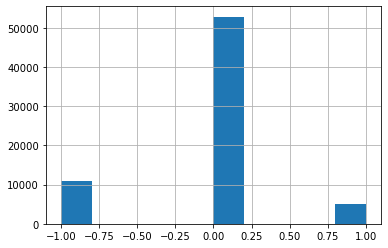

In [24]:
megadata['target'].hist()

In [27]:
test = pd.read_csv( '../input/siim-isic-melanoma-classification/test.csv' ).set_index('image_name',drop=True)
test

,patient_id,sex,age_approx,anatom_site_general_challenge
image_name,,,,
ISIC_0052060,IP_3579794,male,70.0,NaN
ISIC_0052349,IP_7782715,male,40.0,lower extremity
ISIC_0058510,IP_7960270,female,55.0,torso
ISIC_0073313,IP_6375035,female,50.0,torso
ISIC_0073502,IP_0589375,female,45.0,lower extremity
...,...,...,...,...
ISIC_9992485,IP_4152479,male,40.0,torso
ISIC_9996992,IP_4890115,male,35.0,torso
ISIC_9997917,IP_2852390,male,25.0,upper extremity


In [ ]:
megadata

In [28]:
test= megadata.query('source==2020 and train_type==0').set_index('image_name',drop=True)
train= megadata.query('source==2020 and train_type==1').set_index('image_name',drop=True)
train_ext= megadata.query('source==2019').set_index('image_name',drop=True)

In [31]:
# LOAD TRAIN AND TEST CSV
# test = pd.read_csv( '../input/siim-isic-melanoma-classification/test.csv' ).set_index('image_name',drop=True)
# .reindex
test = test.loc[names_test].reset_index()
print('Test csv shape',test.shape)

# train = pd.read_csv( '../input/melanoma-%ix%i/train.csv'%(DIM,DIM) ).set_index('image_name',drop=True)
train = train.loc[names].reset_index()
train.target = train.target.astype('float32')
print('Train csv shape',train.shape)

# LOAD EXTERNAL DATA CSV
# train_ext = pd.read_csv( '../input/isic2019-%ix%i/train.csv'%(DIM,DIM) ).set_index('image_name',drop=True)
train_ext = train_ext.loc[names_ext].reset_index()
train_ext.target = train_ext.target.astype('float32')
print('Train_ext csv shape',train_ext.shape)

print('Displaying train.csv below...')
train.head()

Test csv shape (10875, 13)
Train csv shape (32701, 13)
Train_ext csv shape (25272, 13)
Displaying train.csv below...


,image_name,Unnamed: 0,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,target,source,train_type,downsampled,prev_source,image_size
0,ISIC_2637011,0,IP_7279968,male,45.0,head/neck,unknown,0.0,2020,1,False,NaN,"(6000, 4000)"
1,ISIC_0080817,20,IP_7318404,male,50.0,lower extremity,unknown,0.0,2020,1,False,NaN,"(4288, 2848)"
2,ISIC_0074268,4,IP_8723313,female,55.0,upper extremity,unknown,0.0,2020,1,False,NaN,"(6000, 4000)"
3,ISIC_0087290,36,IP_4050705,female,40.0,torso,unknown,0.0,2020,1,False,NaN,"(6000, 4000)"
4,ISIC_0078703,15,IP_7279968,male,45.0,torso,unknown,0.0,2020,1,False,NaN,"(6000, 4000)"


# RAPIDS cuML kNN - Find Duplicates

## Find Duplicates

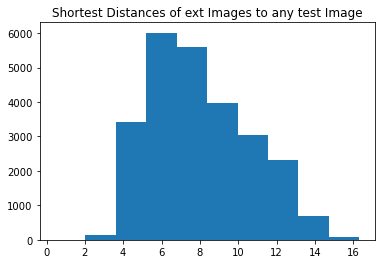

In [32]:
KNN = 3
model = cuml.neighbors.NearestNeighbors(n_neighbors=KNN)
model.fit(embed_test)
distances, indices = model.kneighbors(embed_ext)

mm = np.min(distances,axis=1)
plt.title('Shortest Distances of ext Images to any test Image')
plt.hist(mm)
plt.show()


In [36]:
mm

array([ 9.151874 ,  5.3521824,  7.513825 , ..., 10.30594  , 12.126057 ,
        9.778203 ], dtype=float32)

In [68]:
indices

array([[2216, 8517, 5426],
       [5040, 8634, 4214],
       [ 454, 7636, 3147],
       ...,
       [7597, 5990, 8066],
       [2739, 5444, 3928],
       [2501, 7878, 8030]])

In [77]:
CUTOFF = 2
idx = np.where( (mm<CUTOFF) )[0]
print('There are %i potential duplicate images that have distance < %i'%(len(idx),CUTOFF))

There are 6 potential duplicate images that have distance < 2


In [53]:
idx

array([    0,     1,     2, ..., 25269, 25270, 25271])

In [56]:
train_ext['dist_test'] = 0

In [57]:
train_ext

,image_name,Unnamed: 0,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,target,source,train_type,downsampled,prev_source,image_size,dist_test
0,ISIC_0000000,0,NaN,female,55.0,torso,nevus,0.0,2019,1,False,2017.0,"(1022, 767)",0
1,ISIC_0024306,2883,NaN,male,45.0,NaN,nevus,0.0,2019,1,False,2018.0,"(600, 450)",0
2,ISIC_0000001,1,NaN,female,30.0,torso,nevus,0.0,2019,1,False,2017.0,"(1022, 767)",0
3,ISIC_0024307,2884,NaN,male,50.0,lower extremity,nevus,0.0,2019,1,False,2018.0,"(600, 450)",0
4,ISIC_0000002,2,NaN,female,60.0,upper extremity,melanoma,1.0,2019,1,False,2017.0,"(1022, 767)",0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25267,ISIC_0072357,24697,NaN,male,50.0,lower extremity,Benign keratosis,0.0,2019,1,False,NaN,"(1024, 1024)",0
25268,ISIC_0072358,24698,NaN,female,80.0,torso,melanoma,1.0,2019,1,False,NaN,"(1024, 1024)",0
25269,ISIC_0072359,24699,NaN,male,70.0,head/neck,Basal cell carcinoma,0.0,2019,1,False,NaN,"(1024, 1024)",0
25270,ISIC_0072360,24700,NaN,male,85.0,palms/soles,melanoma,1.0,2019,1,False,NaN,"(1024, 1024)",0


In [69]:
for k in idx:
    train_ext.loc[k,'dist_test'] = float(mm[k])

In [72]:
mm

9.151874

In [70]:
train_ext

,image_name,Unnamed: 0,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,target,source,train_type,downsampled,prev_source,image_size,dist_test
0,ISIC_0000000,0,NaN,female,55.0,torso,nevus,0.0,2019,1,False,9.151874,"(1022, 767)",0
1,ISIC_0024306,2883,NaN,male,45.0,NaN,nevus,0.0,2019,1,False,5.352182,"(600, 450)",0
2,ISIC_0000001,1,NaN,female,30.0,torso,nevus,0.0,2019,1,False,7.513825,"(1022, 767)",0
3,ISIC_0024307,2884,NaN,male,50.0,lower extremity,nevus,0.0,2019,1,False,5.074434,"(600, 450)",0
4,ISIC_0000002,2,NaN,female,60.0,upper extremity,melanoma,1.0,2019,1,False,5.660260,"(1022, 767)",0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25267,ISIC_0072357,24697,NaN,male,50.0,lower extremity,Benign keratosis,0.0,2019,1,False,12.924191,"(1024, 1024)",0
25268,ISIC_0072358,24698,NaN,female,80.0,torso,melanoma,1.0,2019,1,False,12.937170,"(1024, 1024)",0
25269,ISIC_0072359,24699,NaN,male,70.0,head/neck,Basal cell carcinoma,0.0,2019,1,False,10.305940,"(1024, 1024)",0
25270,ISIC_0072360,24700,NaN,male,85.0,palms/soles,melanoma,1.0,2019,1,False,12.126057,"(1024, 1024)",0


## Display Duplicates

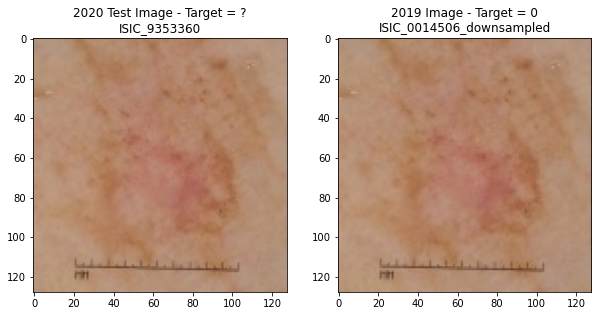

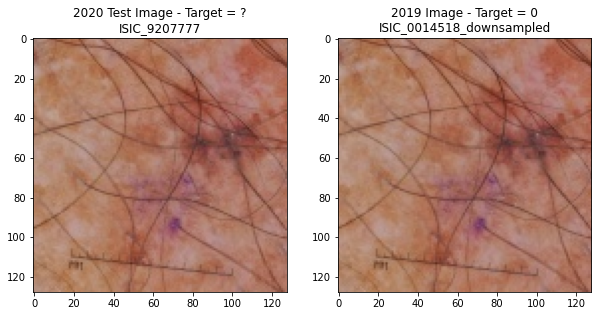

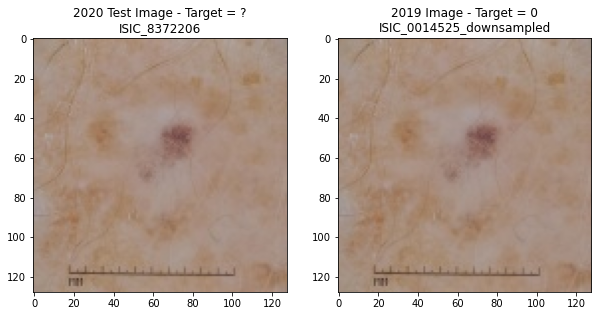

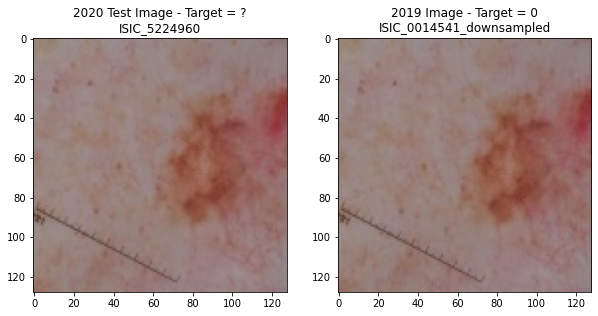

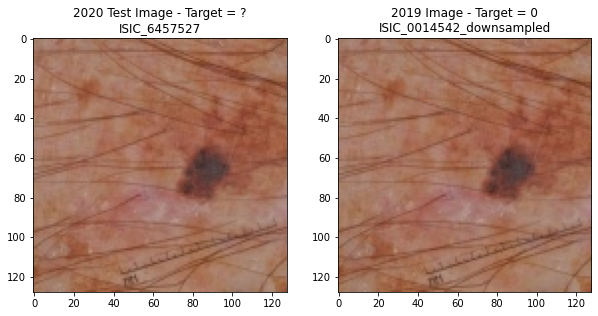

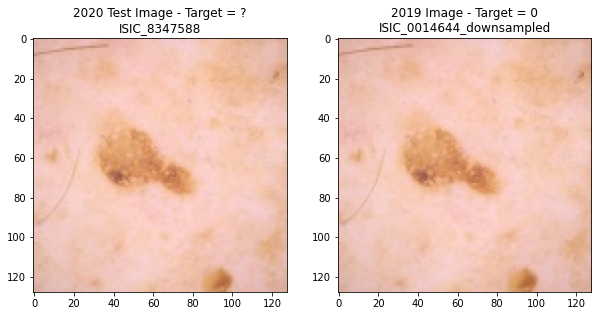

In [78]:
PATH_TEST = '../input/jpeg-melanoma-128x128/test/'
PATH_EXT = '../input/jpeg-isic2019-128x128/train/'

a = []; b = []; c = []

for k in idx:
    
    a.append(names_test[k])
    b.append(train_ext.target.iloc[int(indices[k,0])])
    c.append(names_ext[int(indices[k,0])])
    
    plt.figure(figsize=(10,5))
    
    plt.subplot(1,2,1)
    img = cv2.imread(PATH_TEST+names_test[int(indices[k,0])]+'.jpg')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('2020 Test Image - Target = ?\n%s'%names_test[int(indices[k,0])])

    plt.subplot(1,2,2)
    img = cv2.imread(PATH_EXT+names_ext[k]+'.jpg')
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    t = train_ext.target.iloc[int(indices[k,0])]
    plt.title('2019 Image - Target = %i\n%s'%(t,names_ext[k]))
    
    plt.show()

# RAPIDS cuML KMeans
Embeddings from EfficientNetB0 has dimension 1280. So each image is now represented by a point in 1280 dimension space. Let's cluster these points into 20 clusters and display what images look like in the different clusters.

In [82]:
CLUSTERS = 20
model = cuml.KMeans(n_clusters=CLUSTERS)
model.fit(embed)
train['cluster'] = model.labels_
train.head()

,image_name,Unnamed: 0,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,target,source,train_type,downsampled,prev_source,image_size,cluster
0,ISIC_2637011,0,IP_7279968,male,45.0,head/neck,unknown,0.0,2020,1,False,NaN,"(6000, 4000)",16
1,ISIC_0080817,20,IP_7318404,male,50.0,lower extremity,unknown,0.0,2020,1,False,NaN,"(4288, 2848)",2
2,ISIC_0074268,4,IP_8723313,female,55.0,upper extremity,unknown,0.0,2020,1,False,NaN,"(6000, 4000)",7
3,ISIC_0087290,36,IP_4050705,female,40.0,torso,unknown,0.0,2020,1,False,NaN,"(6000, 4000)",4
4,ISIC_0078703,15,IP_7279968,male,45.0,torso,unknown,0.0,2020,1,False,NaN,"(6000, 4000)",11


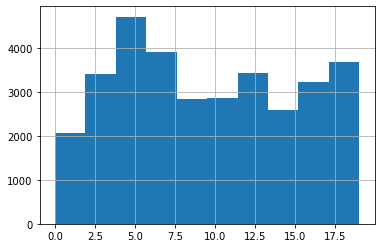

In [83]:
train['cluster'].hist()

#########################
#### Cluster 0 of similar train images
#########################


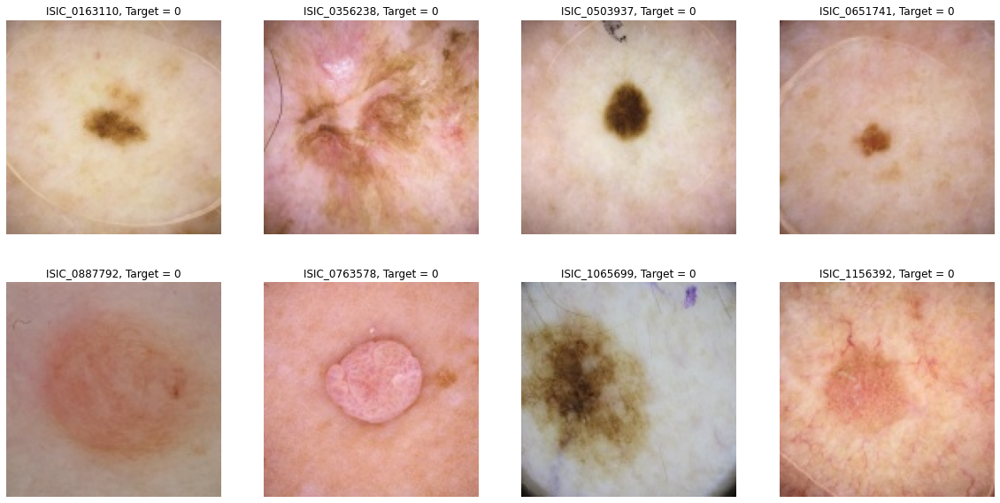

#########################
#### Cluster 1 of similar train images
#########################


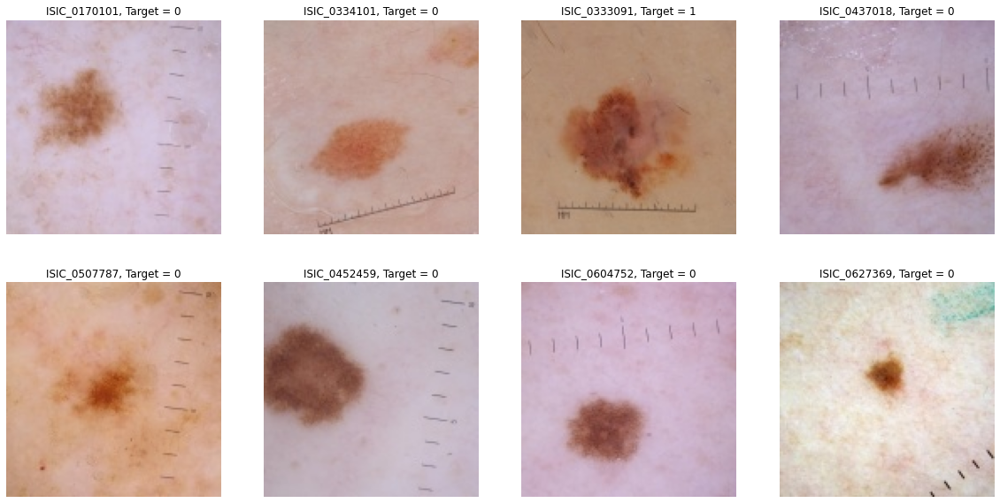

#########################
#### Cluster 2 of similar train images
#########################


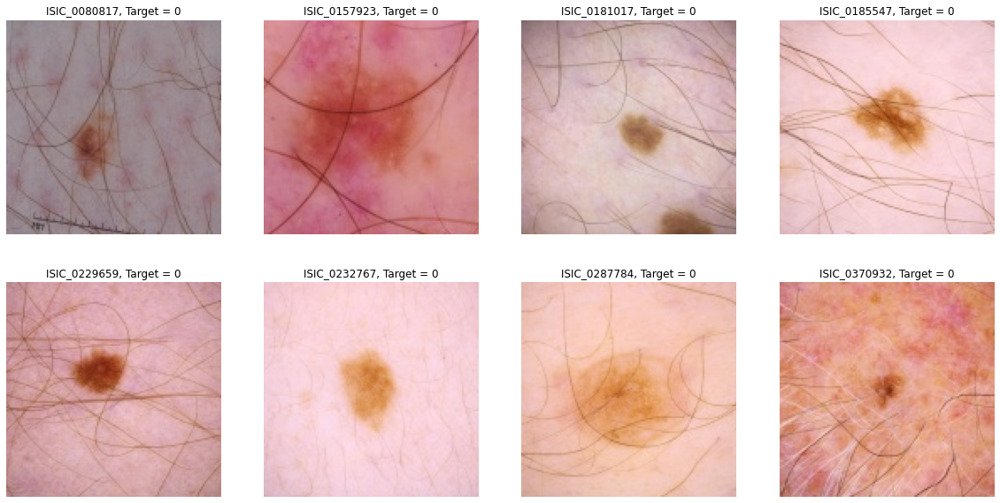

#########################
#### Cluster 3 of similar train images
#########################


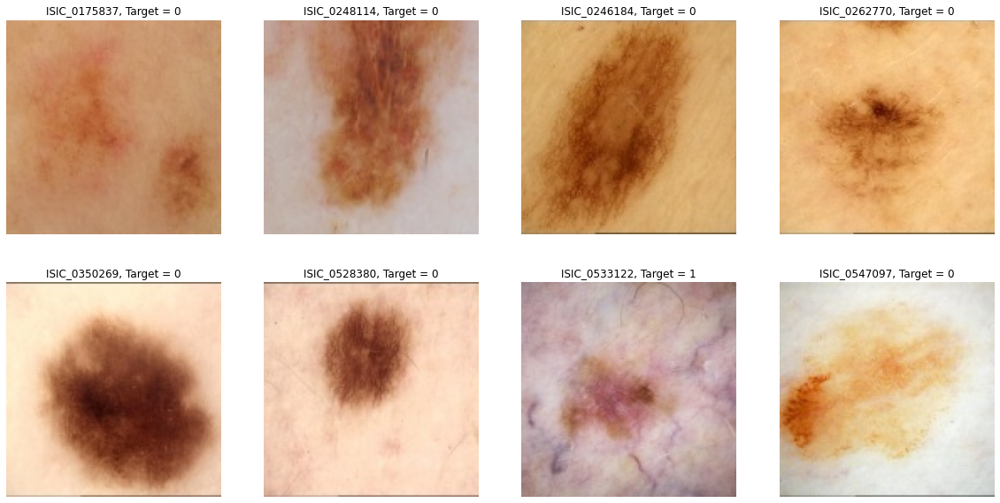

#########################
#### Cluster 4 of similar train images
#########################


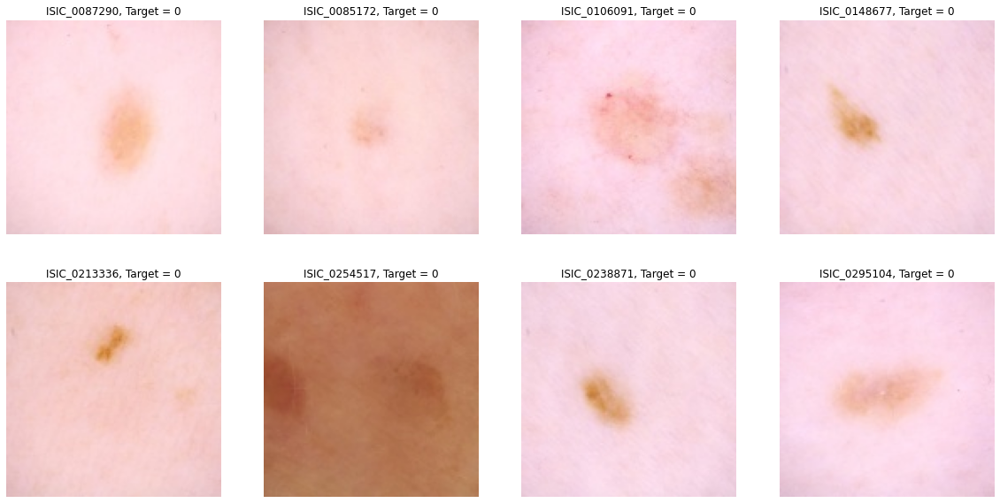

#########################
#### Cluster 5 of similar train images
#########################


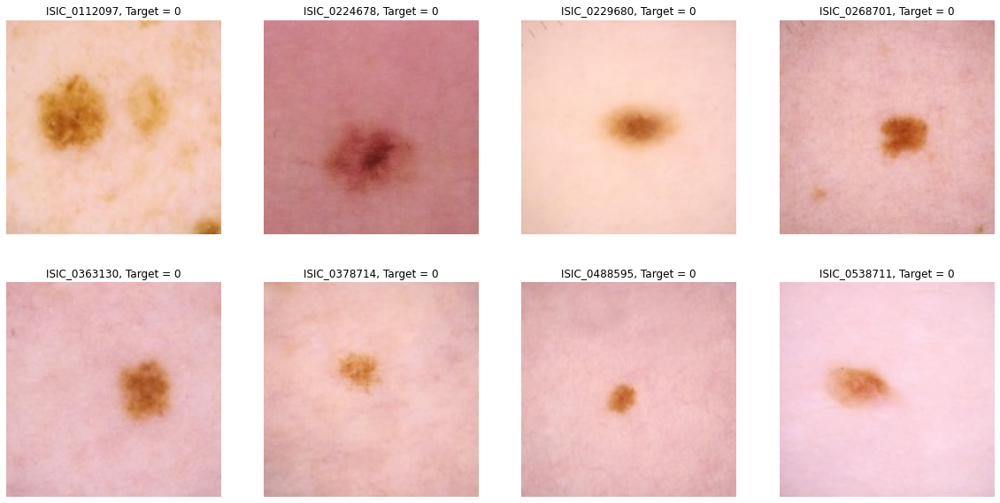

#########################
#### Cluster 6 of similar train images
#########################


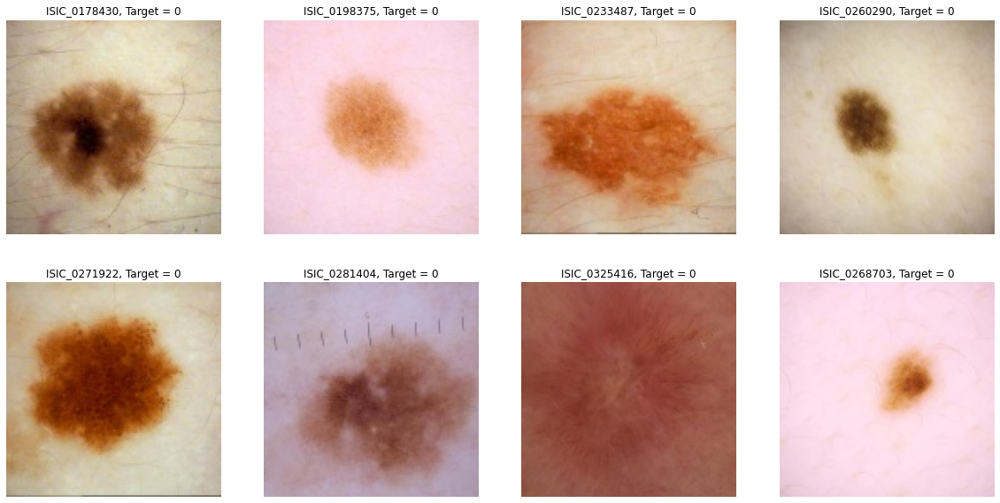

#########################
#### Cluster 7 of similar train images
#########################


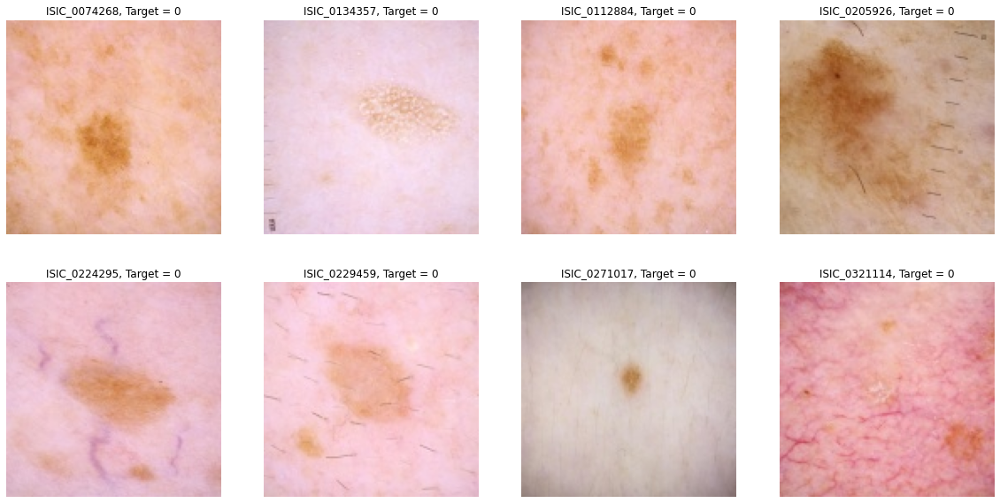

#########################
#### Cluster 8 of similar train images
#########################


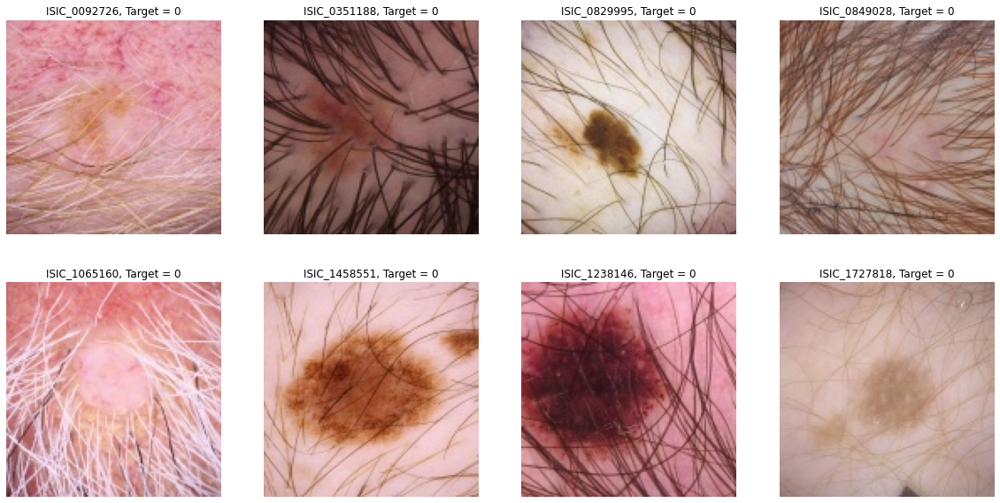

#########################
#### Cluster 9 of similar train images
#########################


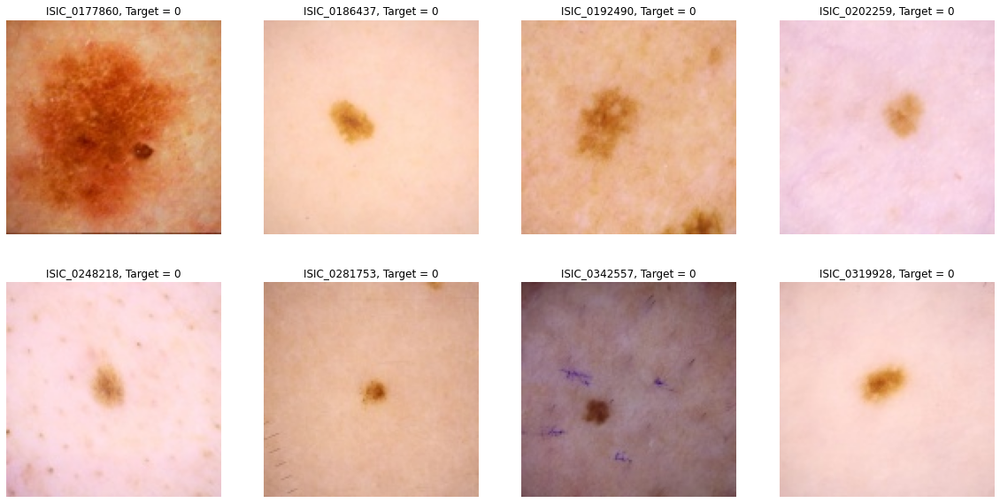

#########################
#### Cluster 10 of similar train images
#########################


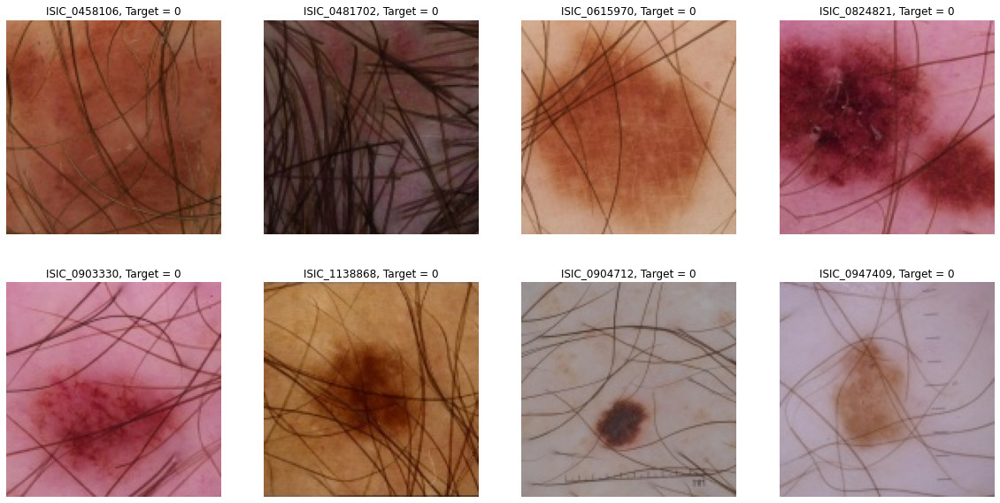

#########################
#### Cluster 11 of similar train images
#########################


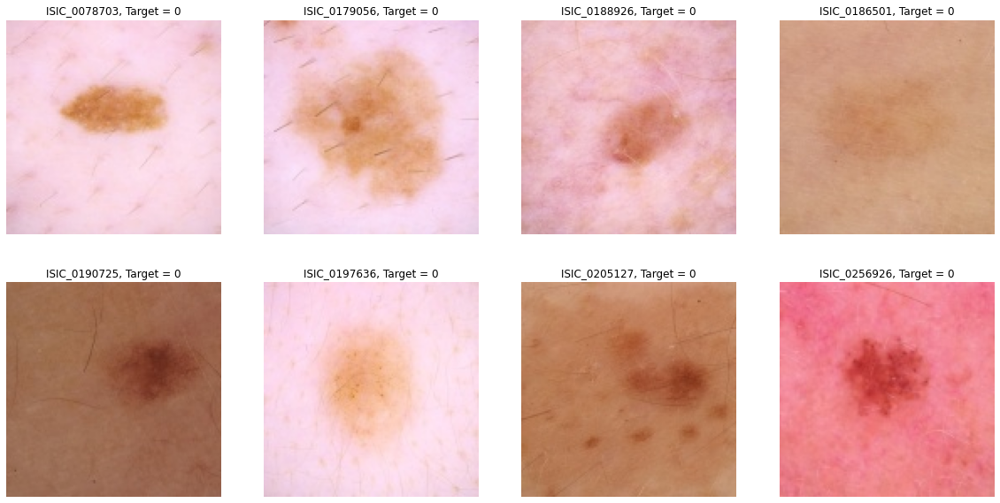

#########################
#### Cluster 12 of similar train images
#########################


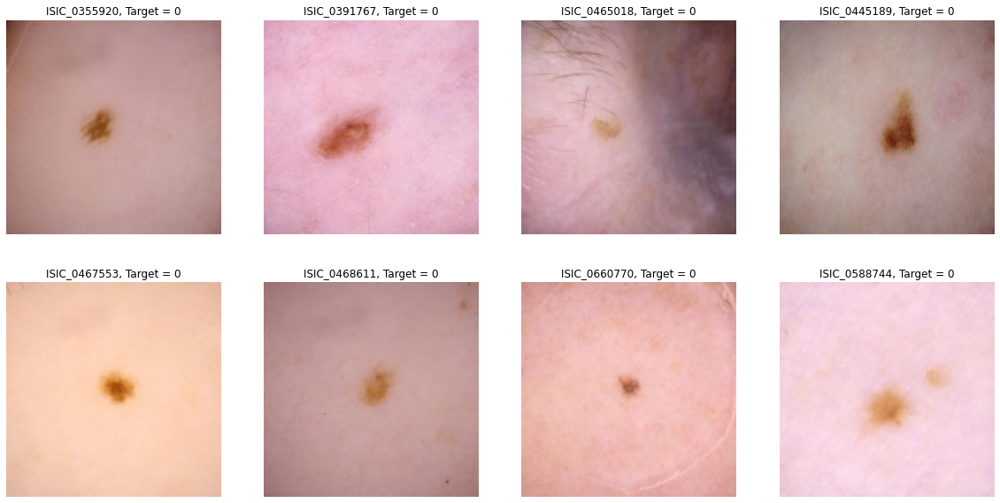

#########################
#### Cluster 13 of similar train images
#########################


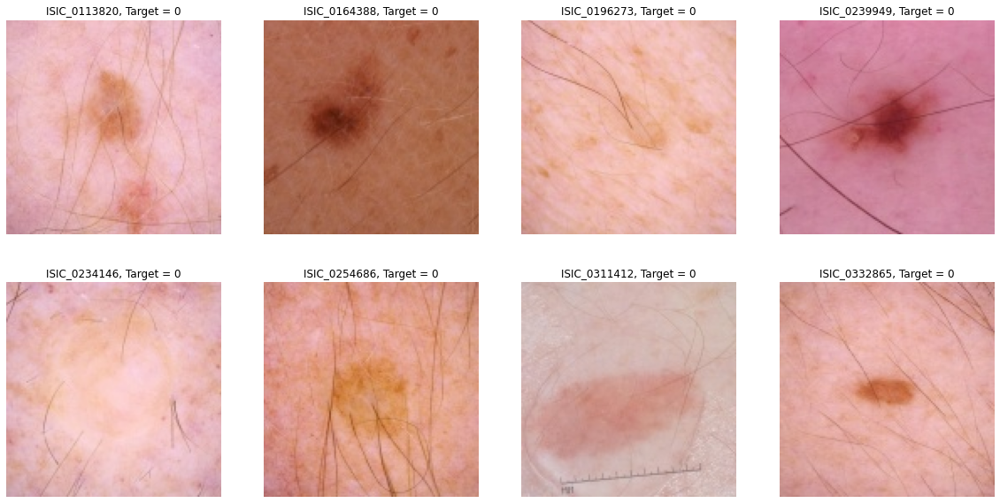

#########################
#### Cluster 14 of similar train images
#########################


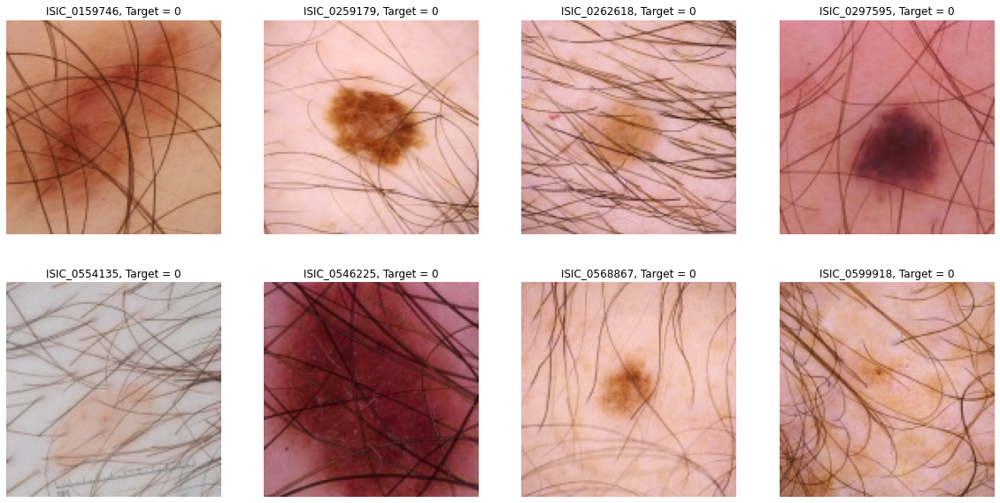

#########################
#### Cluster 15 of similar train images
#########################


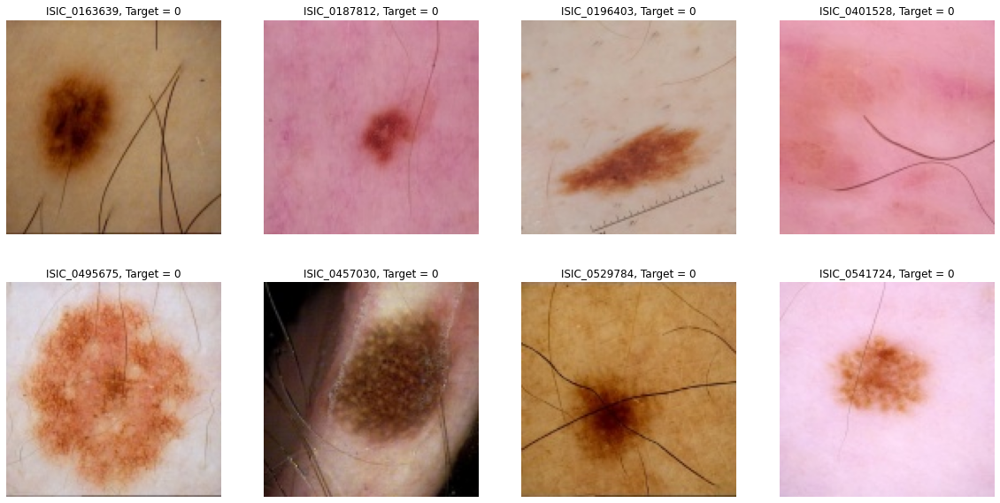

#########################
#### Cluster 16 of similar train images
#########################


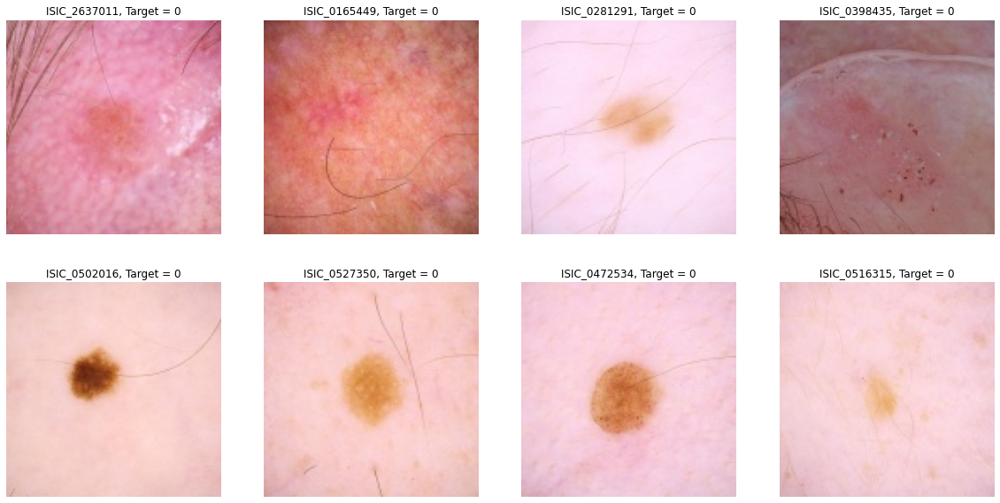

#########################
#### Cluster 17 of similar train images
#########################


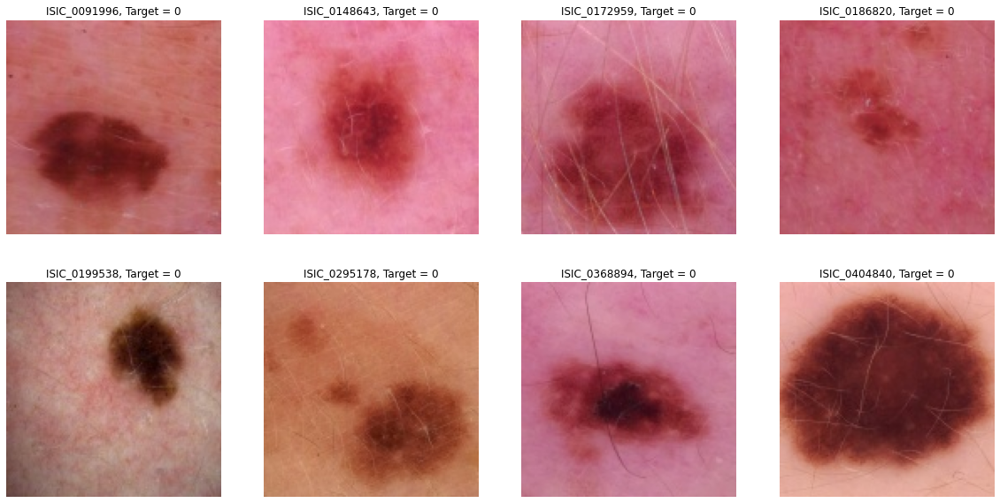

#########################
#### Cluster 18 of similar train images
#########################


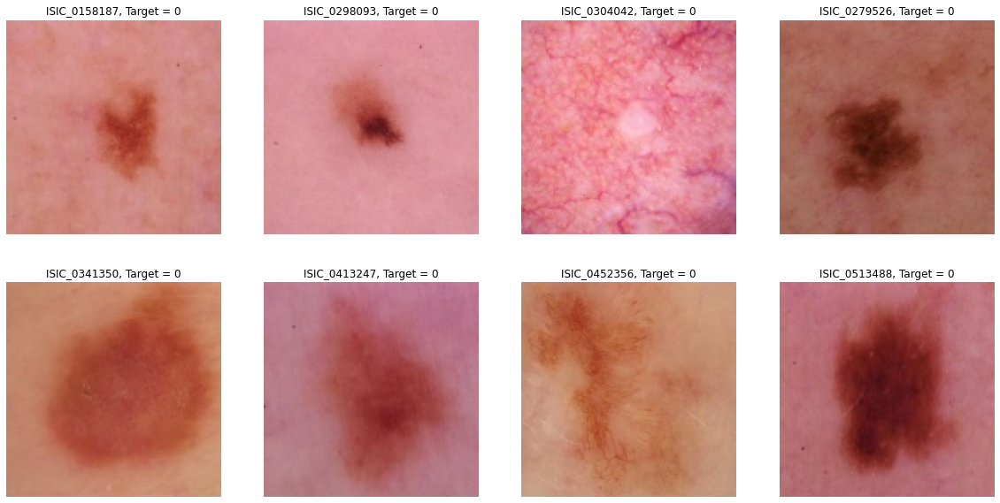

#########################
#### Cluster 19 of similar train images
#########################


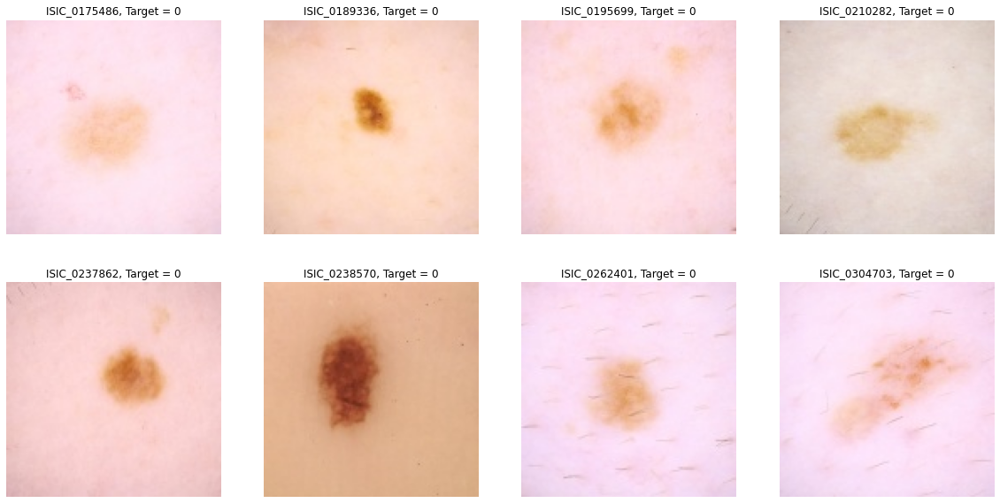

In [84]:
PATH_TRAIN = '../input/jpeg-melanoma-128x128/train/'

for k in range(CLUSTERS):
    print('#'*25);
    print('#### Cluster %i of similar train images'%k)
    print('#'*25)
    df = train.loc[train.cluster==k]
    plt.figure(figsize=(20,10))
    for j in range(8):
        plt.subplot(2,4,j+1)
        img = cv2.imread(PATH_TRAIN+names[df.index[j]]+'.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.axis('off')
        plt.title('%s, Target = %i'%(names[df.index[j]],df.loc[df.index[j],'target']))
        plt.imshow(img)  
    plt.show()
    

# RAPIDS cuML TSNE
Embeddings from EfficientNetB0 has dimension 1280. So each image is now represented by a point in 1280 dimension space. Let's map this 1280 dimensional space to 2 dimensions. Below we plot each image's new 2 dimension representation. We color benign orange and malignant blue. Next we will find a random square in this 2 dimensional space and plot some of the images inside the square.

In [85]:
model = cuml.TSNE()
embed2D = model.fit_transform(embed)
train['x'] = embed2D[:,0]
train['y'] = embed2D[:,1]

In [86]:
X_DIV = 10; Y_DIV = 10
x_min = train.x.min()
x_max = train.x.max()
y_min = train.y.min()
y_max = train.y.max()
x_step = (x_max - x_min)/X_DIV
y_step = (y_max - y_min)/Y_DIV
mx = 0; xa_mx = 0; xb_mx=0; ya_mx = 0; yb_mx = 0
for k in range(X_DIV+1):
    for j in range(Y_DIV+1):
        xa = k*x_step + x_min
        xb = (k+1)*x_step + x_min
        ya = j*y_step + y_min
        yb = (j+1)*y_step + y_min
        df = train.loc[(train.x>xa)&(train.x<xb)&(train.y>ya)&(train.y<yb)]
        t = df.target.mean()
        if (t>mx)&(len(df)>=16):
            mx = t
            xa_mx = xa
            xb_mx = xb
            ya_mx = ya
            yb_mx = yb
        #print(k,j,t)

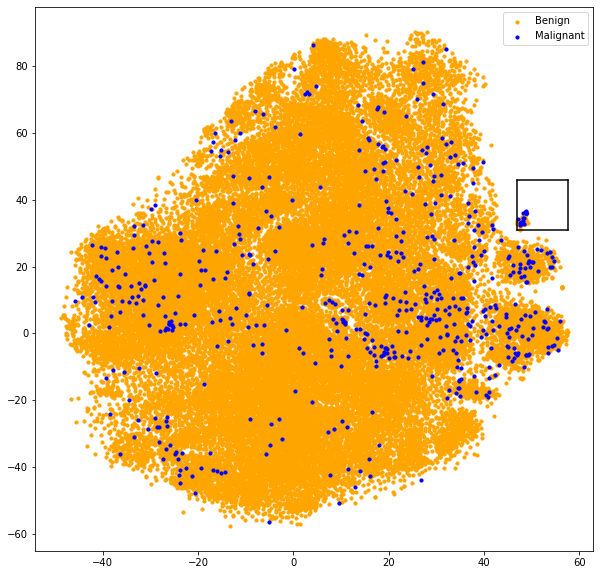

In [87]:
plt.figure(figsize=(10,10))
df1 = train.loc[train.target==0]
plt.scatter(df1.x,df1.y,color='orange',s=10,label='Benign')
df2 = train.loc[train.target==1]
plt.scatter(df2.x,df2.y,color='blue',s=10,label='Malignant')
plt.plot([xa_mx,xa_mx],[ya_mx,yb_mx],color='black')
plt.plot([xa_mx,xb_mx],[ya_mx,ya_mx],color='black')
plt.plot([xb_mx,xb_mx],[ya_mx,yb_mx],color='black')
plt.plot([xa_mx,xb_mx],[yb_mx,yb_mx],color='black')
plt.legend()
plt.show()

This region has 23.36 % malignant


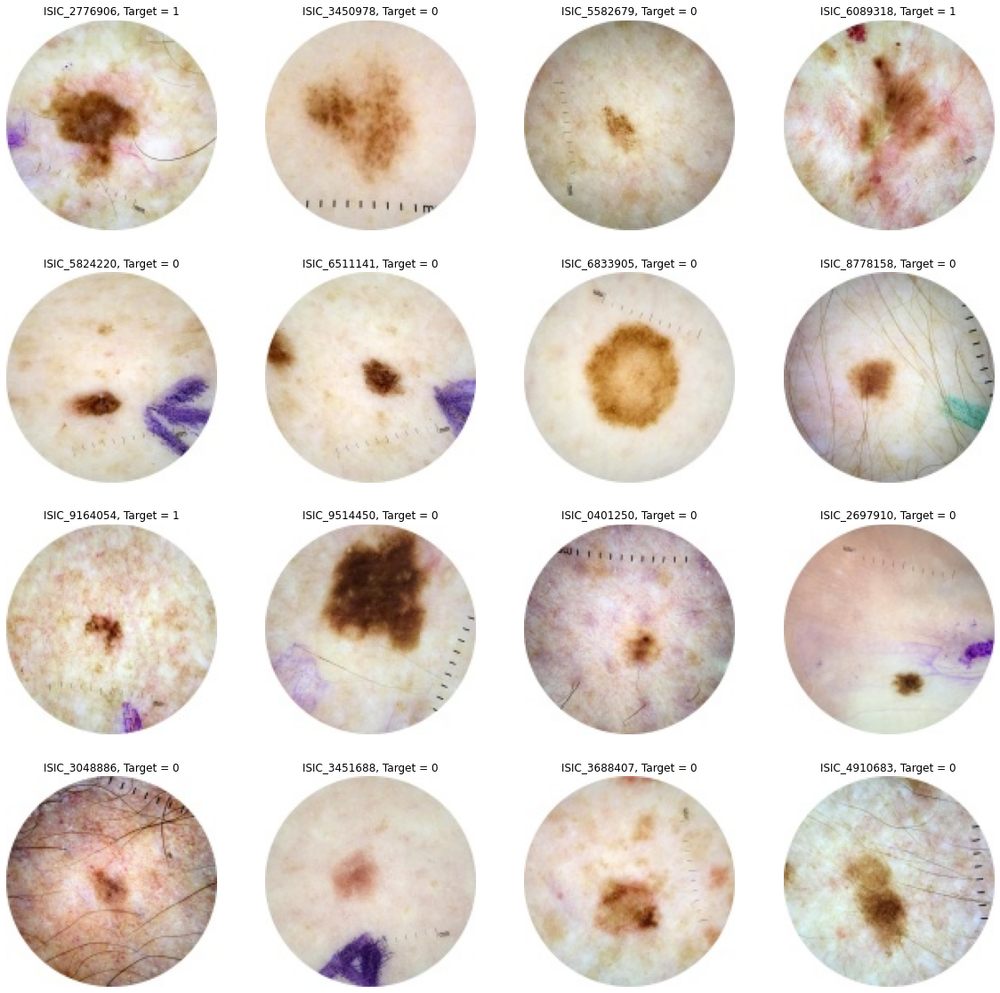

In [88]:
df = train.loc[(train.x>xa_mx)&(train.x<xb_mx)&(train.y>ya_mx)&(train.y<yb_mx)]
print('This region has %.2f %% malignant'%(100*df.target.mean())) 

ROW = 4
COL = 4
plt.figure(figsize=(20,20*ROW/COL))
for k in range(ROW):
    for j in range(COL):
        plt.subplot(ROW,COL,k*COL+j+1)
        img = cv2.imread(PATH_TRAIN+names[df.index[k*COL+j]]+'.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        plt.axis('off')
        plt.title('%s, Target = %i'%(names[df.index[k*COL+j]],df.loc[df.index[k*COL+j],'target']))
        plt.imshow(img)  
plt.show()

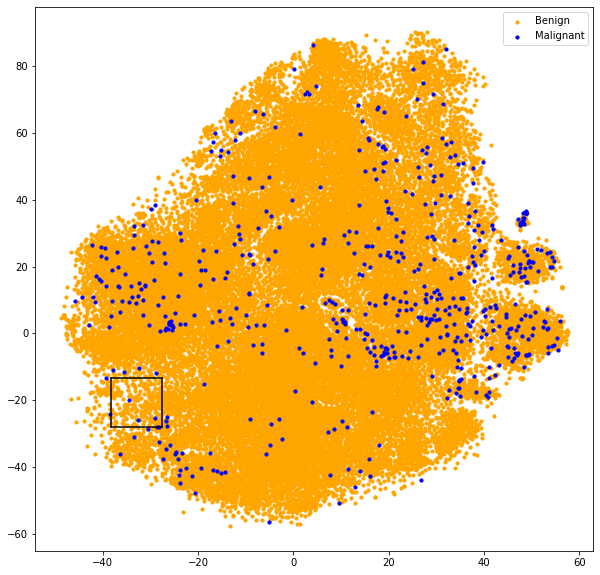

This region has 1.22 % malignant


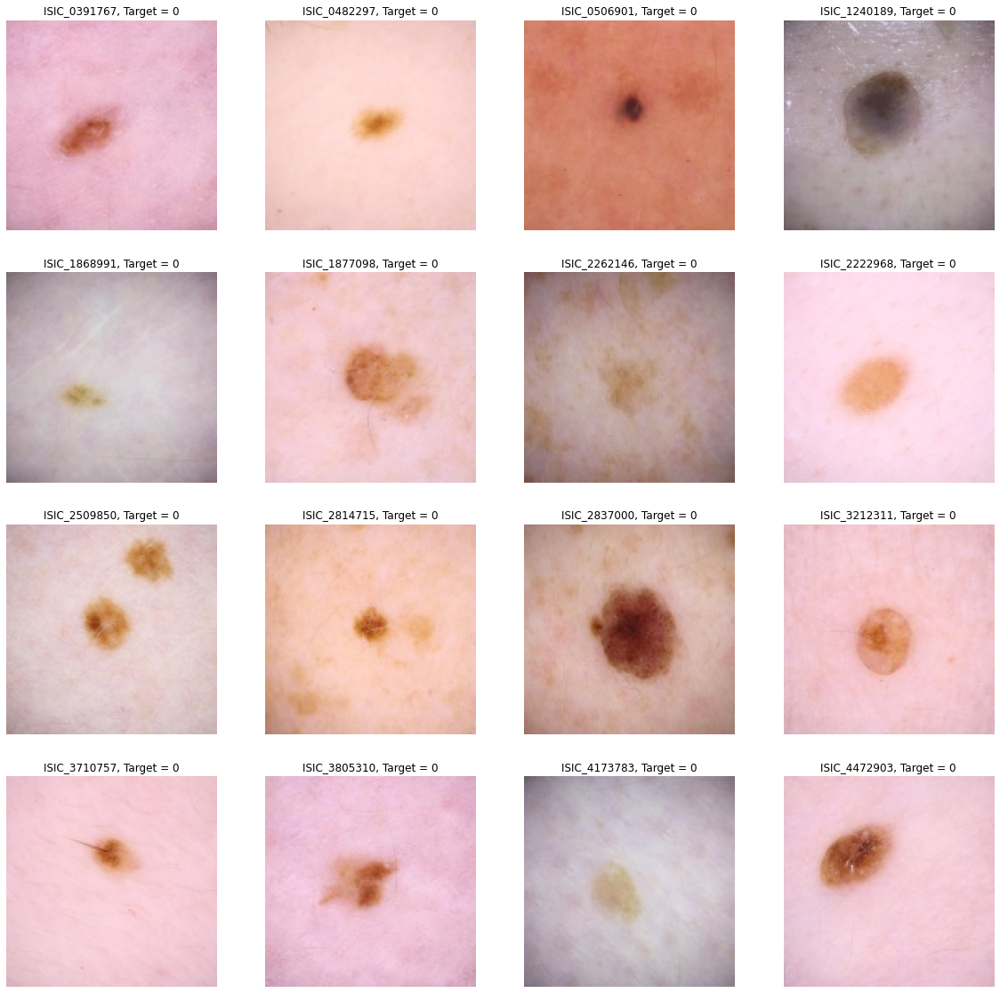

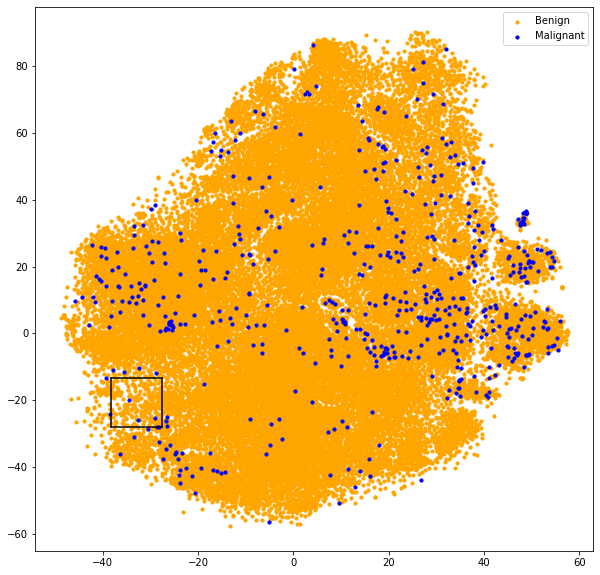

This region has 1.22 % malignant


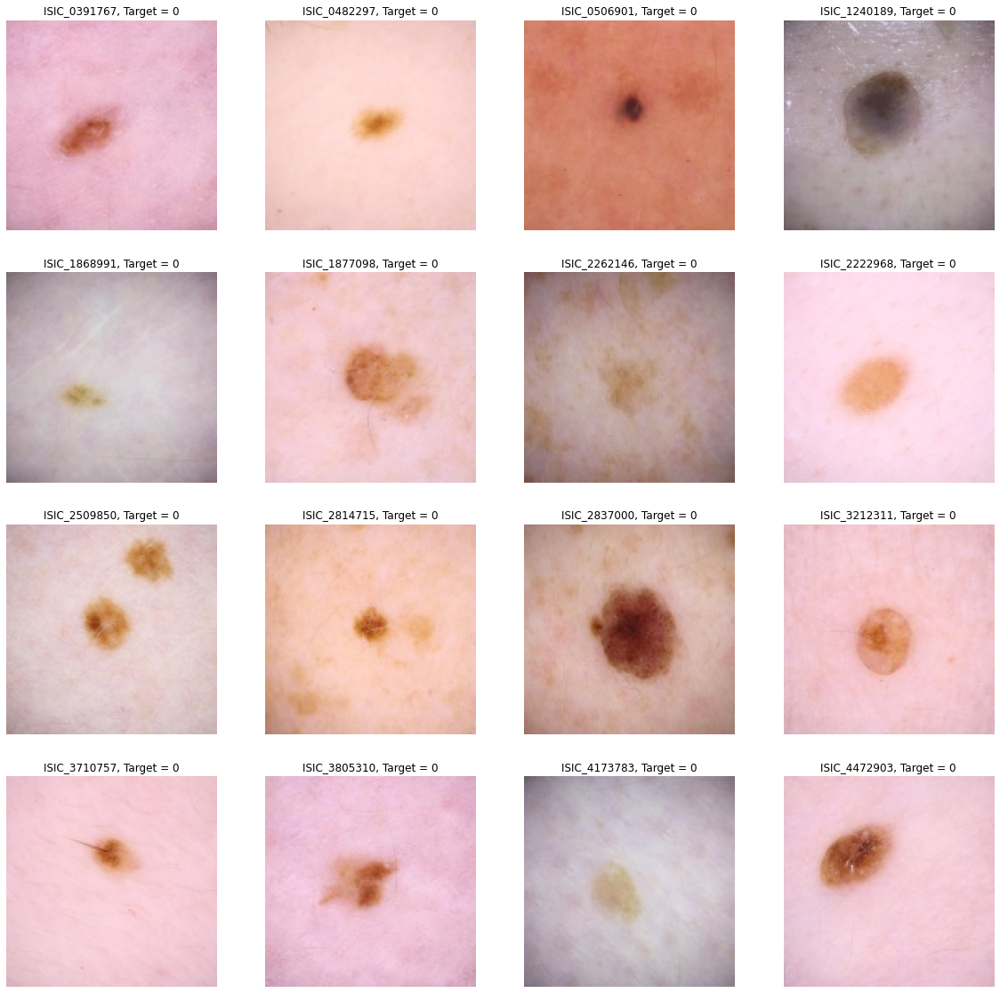

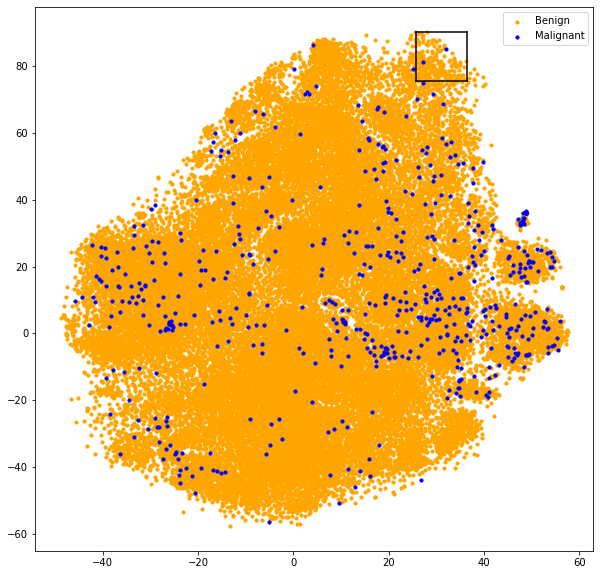

This region has 1.10 % malignant


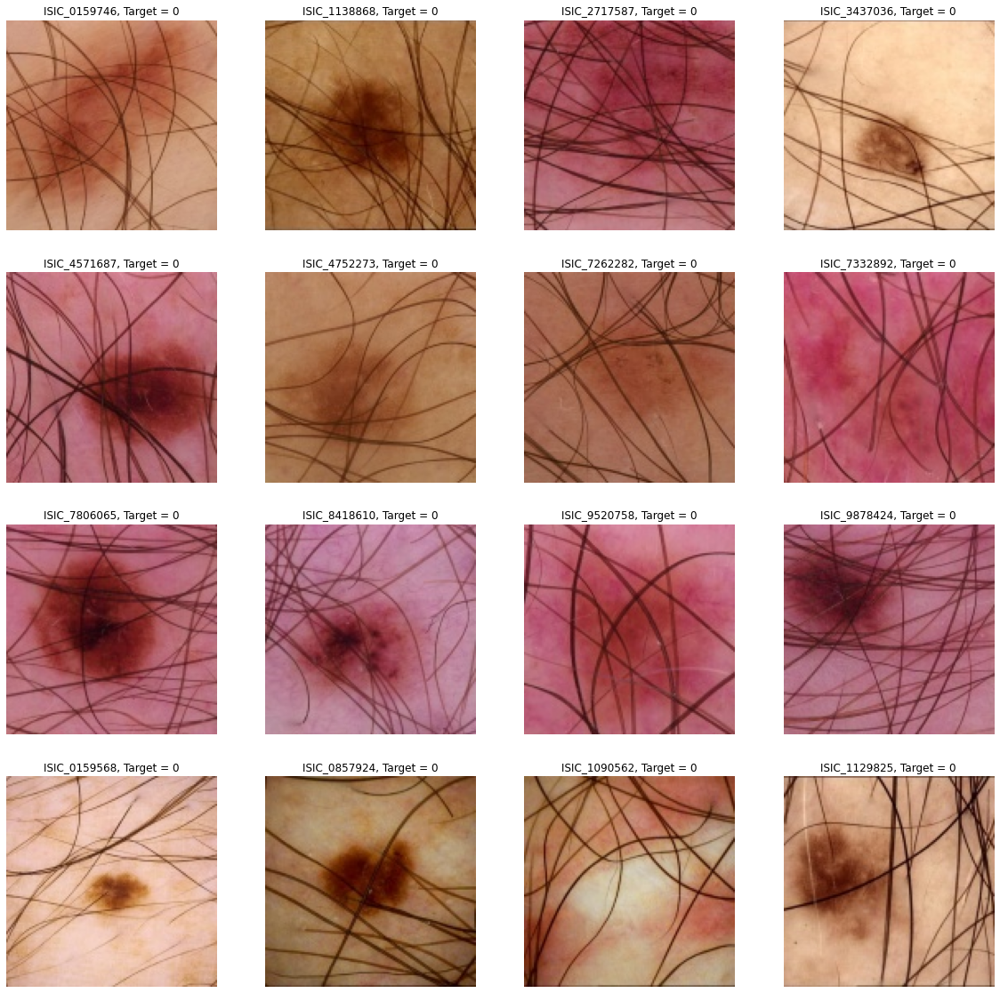

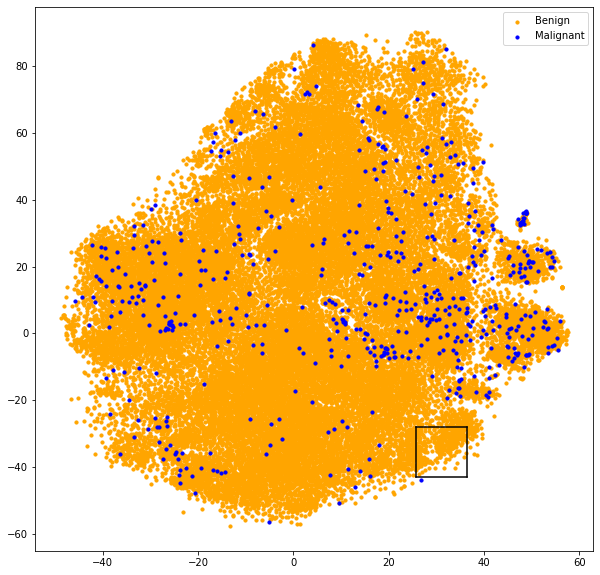

This region has 0.00 % malignant


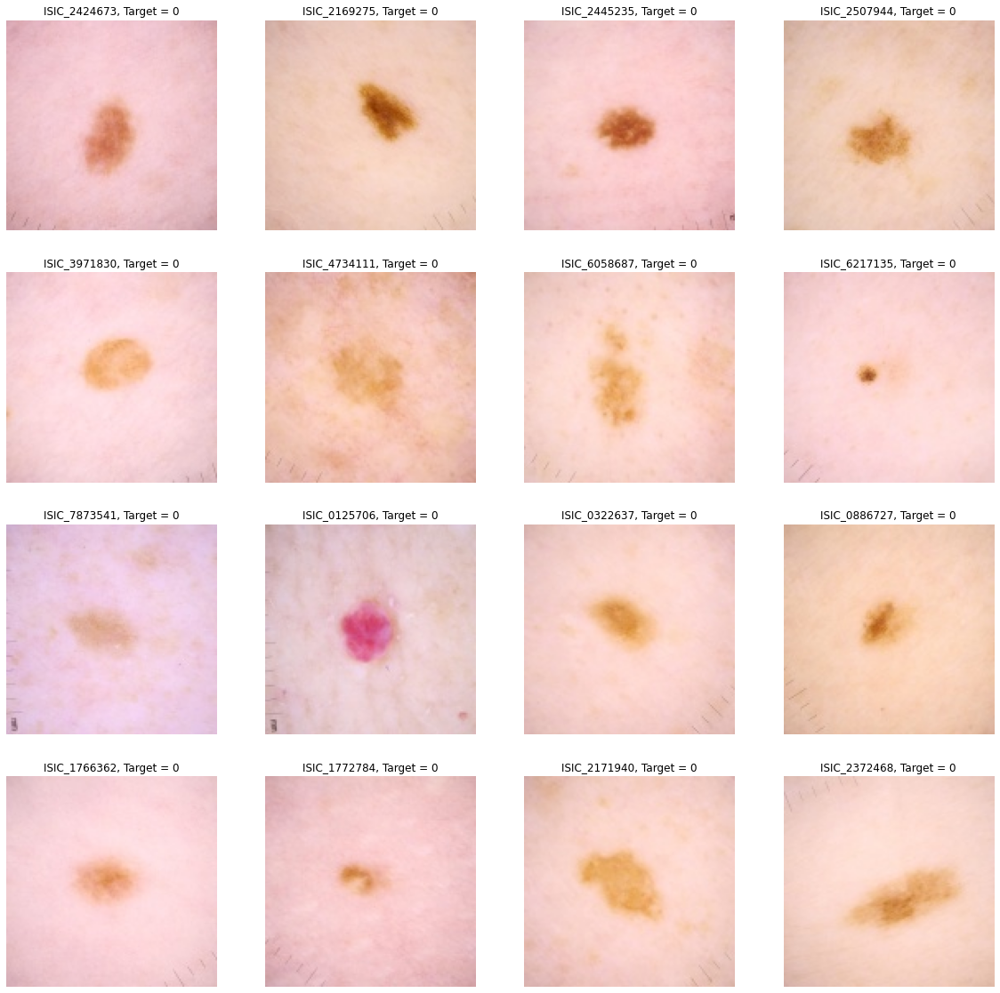

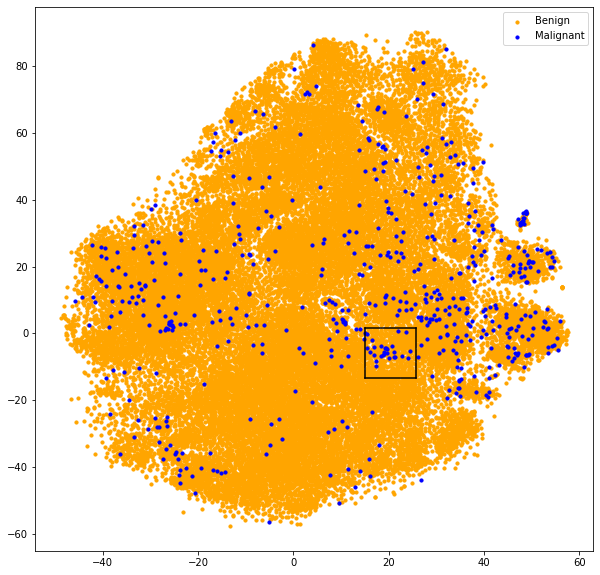

This region has 4.52 % malignant


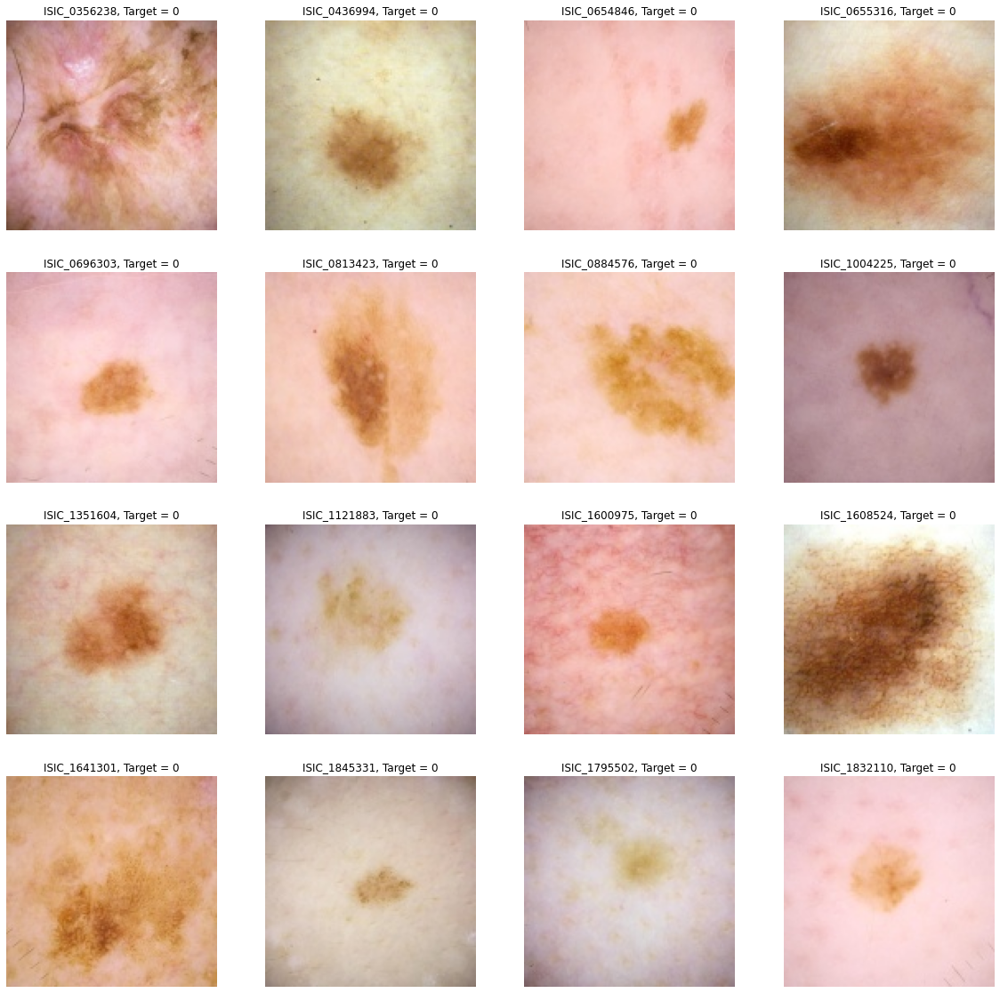

In [89]:
for it in range(5):
    i = 0
    while i<16:
        k = np.random.randint(0,X_DIV)
        j = np.random.randint(0,Y_DIV)
        xa_mx = k*x_step + x_min
        xb_mx = (k+1)*x_step + x_min
        ya_mx = j*y_step + y_min
        yb_mx = (j+1)*y_step + y_min
        df = train.loc[(train.x>xa_mx)&(train.x<xb_mx)&(train.y>ya_mx)&(train.y<yb_mx)]
        i = len(df)

    plt.figure(figsize=(10,10))
    df1 = train.loc[train.target==0]
    plt.scatter(df1.x,df1.y,color='orange',s=10,label='Benign')
    df2 = train.loc[train.target==1]
    plt.scatter(df2.x,df2.y,color='blue',s=10,label='Malignant')
    plt.plot([xa_mx,xa_mx],[ya_mx,yb_mx],color='black')
    plt.plot([xa_mx,xb_mx],[ya_mx,ya_mx],color='black')
    plt.plot([xb_mx,xb_mx],[ya_mx,yb_mx],color='black')
    plt.plot([xa_mx,xb_mx],[yb_mx,yb_mx],color='black')
    plt.legend()
    plt.show()

    print('This region has %.2f %% malignant'%(100*df.target.mean()))    
    
    ROW = 4
    COL = 4
    plt.figure(figsize=(20,20*ROW/COL))
    for k in range(ROW):
        for j in range(COL):
            plt.subplot(ROW,COL,k*COL+j+1)
            img = cv2.imread(PATH_TRAIN+names[df.index[k*COL+j]]+'.jpg')
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.axis('off')
            plt.title('%s, Target = %i'%(names[df.index[k*COL+j]],df.loc[df.index[k*COL+j],'target']))
            plt.imshow(img)  
    plt.show()